# PROJECT M-AI-D: Shape Model Inference Notebook

## Imports

Model was trained in fastai

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from fastai.data.all import *
from fastai.vision.all import *
from fastai.callback.wandb import *
import fastai.distributed # accelerator error -> pip install accelerate -U
import torch as tc
import pdb
from tqdm.notebook import tqdm

from maid_tools_lean import *
from shape_model_lean import *
import os
import sys

## Load pretrained Fastai Shape Model and Path to Img Dataset

Download the model and the preprocessed dataset of images here from here: https://osf.io/z2jby/ . Place model and unzipped dataset so the file structure is as follows:

> project m-ai-d/
>> LoadModelInferenceNotebook.ipynb <br>
>> maid_tools_lean.py <br>
>> models/ <br>
>>> rshape-rn50-224-wb-flex-38ep-bs500.pth

> preproc/
>> 224/
>>> WB_FLEX/
>>>> NS001/ <br>
>>>> : <br>
>>>> : <br>
>>>> RS121_FU/ 

In [3]:
# model_name = 'shape-rn50-512-wb-flex-18ep-adaptivepool'
model_name = 'shape-rn50-224-wb-flex-38ep-bs500'
res = 224 # image resolution
exp = "WB_FLEX" # weight-bearing flexion movement experiment
path_preproc = '../preproc/'+str(res) + '/' + exp

## Create Fastai Dataloader

In [4]:
all_files = []
pcode_dirs = os.listdir(path_preproc)
for path in pcode_dirs:
    filenames = os.listdir(path_preproc + '/'+ path)
    for fname in filenames:
        img_filepath = Path(path_preproc + '/' + path + '/'+ fname)
        all_files.append(img_filepath)
# print(all_files[0:5], all_files[-5:-1])

In [5]:
bs = 16 # set batch size
dls, _ = get_dls_infer(all_files, res, bs = bs)

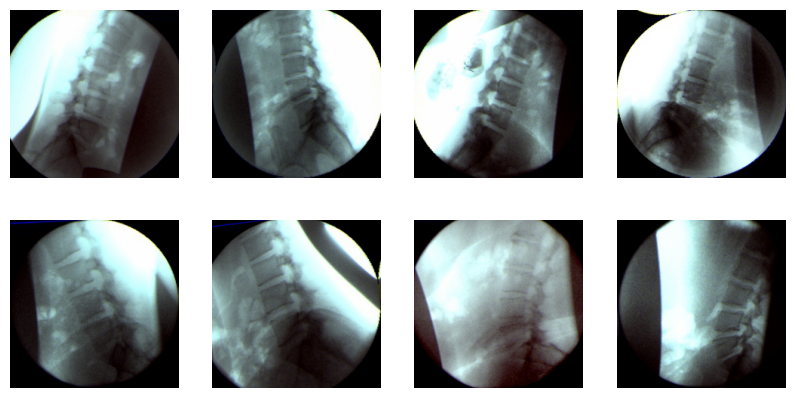

In [6]:
dls.show_batch(max_n=8, figsize=(10,5))

## Create Fastai Vision Learner and Load Pretrained Shape Model

In [7]:
scaler = 1024.0/448.0

class Shape2Points(nn.Module):
    def __init__(self):
        super().__init__()
        components = tc.rand(33,36)
        mean_shape = tc.rand(36)        
        self.register_buffer('components', components)
        self.register_buffer('mean_shape', mean_shape)

    def forward(self, x):
        shapes = get_shapes(x, components=self.components, mean_shape=self.mean_shape) 
        return ((shapes / 224.) - scaler)/scaler  # shape_model uses 1024x1024 resolution, so scaling uses a constant 1024/4.571=224 to get -1..1    

In [8]:
shape_layer = Shape2Points()

In [9]:
learn = vision_learner(dls,
                       resnet50,
                       n_out=6+30,
                       cbs=[ShowGraphCallback()],
                       loss_func=MSELossFlat)
# AttentionPooling
learn.model[-1] = nn.Sequential(AttentionPool2d(2048, 2048, 2), *learn.model[-1][1:5], nn.LeakyReLU(inplace=True), *learn.model[-1][6:], shape_layer)

In [10]:
learn.load(model_name)

/home/rantistic/anaconda3/envs/t1_2_pytorchvid/lib/python3.9/site-packages/fastai/learner.py:57: UserWarning: Could not load the optimizer state.
  if with_opt: warn("Could not load the optimizer state.")


In [11]:
learn.model[-1]

Sequential(
  (0): AttentionPool2d()
  (1): fastai.layers.Flatten(full=False)
  (2): BatchNorm1d(4096, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (3): Dropout(p=0.25, inplace=False)
  (4): Linear(in_features=4096, out_features=512, bias=False)
  (5): LeakyReLU(negative_slope=0.01, inplace=True)
  (6): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (7): Dropout(p=0.5, inplace=False)
  (8): Linear(in_features=512, out_features=36, bias=False)
  (9): Shape2Points()
)

## Create a Data Loader for Inference

In [12]:
test_dl = learn.dls.test_dl(all_files)
test_dl

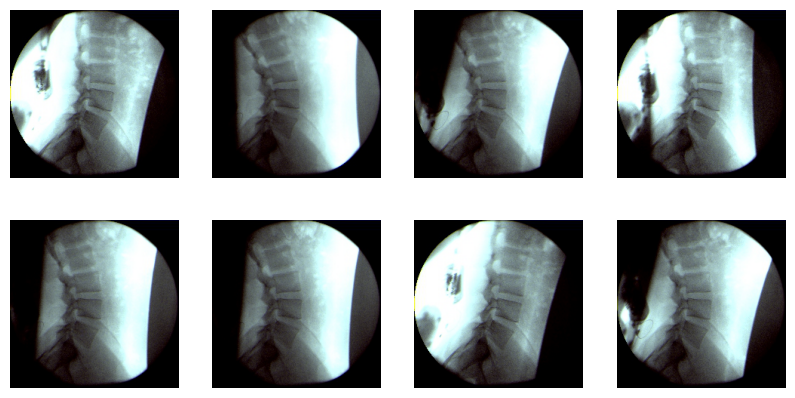

In [13]:
test_dl.show_batch(max_n=8, figsize=(10,5))

## Predict Points

In [14]:
with_input = False # set to false if img passed in isn't required
if with_input == True:
    img_ins, preds,_ = learn.get_preds(dl=test_dl, with_input=True)#dls, ds_type=DatasetType.Test)
else:
    preds,_ = learn.get_preds(dl=test_dl, with_input = False)#, with_input=True)#dls, ds_type=DatasetType.Test)

## Plot Predictions

### Interactive Single Frame

In [15]:
idx_to_plot = 20000 #<-selecting random img filepath in dataset

In [16]:
filename = str(all_files[idx_to_plot])
filename

'../preproc/224/WB_FLEX/RS097/76.jpg'

In [17]:
if with_input == True:
    print(img_ins.shape)
    example_frame = ((img_ins.numpy()[idx_to_plot,0,:,:]*0.25)+1)*255 #<-scale up to grayscale
else:
    import cv2
    example_frame = cv2.imread(filename)[:,:,0]
example_frame

array([[  0,   0,   0, ..., 164, 164, 164],
       [  0,   0,   0, ...,  92,  92,  92],
       [  0,   0,   0, ...,   9,   9,   9],
       ...,
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0]], dtype=uint8)

In [18]:
preds_np = preds.numpy().copy()

In [19]:
points = preds_np[idx_to_plot].reshape(-1,2).copy()
points_shifted = points.copy()
#outputs from model is -1.0 to 1.0, therefore need to rescale to 0.0 to 1.0 for plotting
points_shifted[:,0] = ((points[:,0]+1)) * 0.5
points_shifted[:,1] = ((points[:,1]+1)) * 0.5
print("MAX:\t\t", points.max(), "\t| MIN:\t\t", points.min())
print("MAX_SHIFTED:\t", points_shifted.max(), "\t| MIN_SHIFTED:\t", points_shifted.min())

MAX:		 0.5417759 	| MIN:		 -0.80140066
MAX_SHIFTED:	 0.770888 	| MIN_SHIFTED:	 0.09929967


In [20]:
fig = plot_img(example_frame, str(all_files[idx_to_plot]))#, show = True)

In [21]:
fig = plot_points(fig, series_name = 'pred', img_size = (res,res), x = points_shifted[:,0], y= points_shifted[:,1])

entering plot points function
(5, 4) [[ 70.3058    77.49143  109.77492  103.316124]
 [ 79.59567   85.03182  117.77103  112.25856 ]
 [ 87.05525   89.21953  122.2298   119.969154]
 [ 90.84586   86.32401  117.136215 122.765335]
 [ 85.606705 112.77985  112.77985  112.77985 ]]


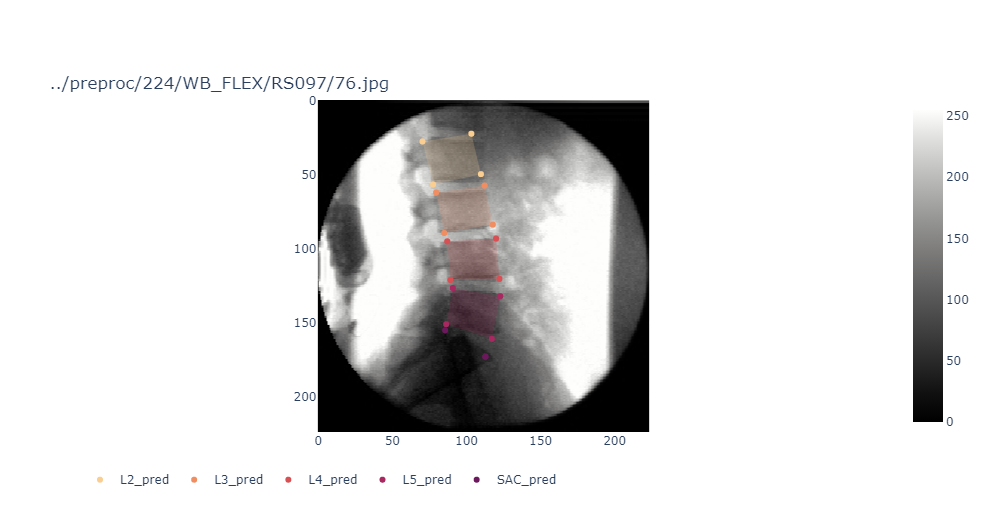

In [22]:
fig.show()

### Interactive Sequence of Predictions

In [23]:
pcode_to_plot= filename.split('/')[-2]
# pcode_to_plot = "RS120"

In [24]:
preds_np_shaped = preds_np.reshape(-1,36)

In [25]:
#create dataframe with predicted points, and frame numbers 
df = pd.DataFrame(columns = ["PatientCode", "Experiment", "Frame",
                             "L2_TL_X", "L2_TL_Y", "L2_BL_X", "L2_BL_Y", "L2_BR_X", "L2_BR_Y", "L2_TR_X", "L2_TR_Y",
                            "L3_TL_X", "L3_TL_Y", "L3_BL_X", "L3_BL_Y", "L3_BR_X", "L3_BR_Y", "L3_TR_X", "L3_TR_Y",
                            "L4_TL_X", "L4_TL_Y", "L4_BL_X", "L4_BL_Y", "L4_BR_X", "L4_BR_Y", "L4_TR_X", "L4_TR_Y",
                             "L5_TL_X", "L5_TL_Y", "L5_BL_X", "L5_BL_Y", "L5_BR_X", "L5_BR_Y", "L5_TR_X", "L5_TR_Y",
                            "SAC_TL_X", "SAC_TL_Y", "SAC_TR_X", "SAC_TR_Y"])


for idx , file_path in enumerate(all_files):
    if pcode_to_plot in str(file_path):
        if pcode_to_plot+"_FU" not in str(file_path):
            
            frame_no = int(str(file_path).split('/')[-1].split('.')[0])
            
            df.loc[idx, :'Frame'] = [pcode_to_plot, exp, frame_no]
            df.loc[idx, 'L2_TL_X':] = ((preds_np_shaped[idx]+1)*0.5) * 1024

df = df.sort_values(by="Frame")#.reset_index(drop = True)
df

,PatientCode,Experiment,Frame,L2_TL_X,L2_TL_Y,L2_BL_X,L2_BL_Y,L2_BR_X,L2_BR_Y,L2_TR_X,...,L5_BL_X,L5_BL_Y,L5_BR_X,L5_BR_Y,L5_TR_X,L5_TR_Y,SAC_TL_X,SAC_TL_Y,SAC_TR_X,SAC_TR_Y
19833,RS097,WB_FLEX,0,169.14978,177.998169,233.559174,298.038635,363.767059,227.1521,304.343262,...,356.985291,691.037964,497.223328,714.757324,502.328918,588.217651,357.487549,707.52478,485.482483,770.865234
20088,RS097,WB_FLEX,1,167.473419,174.013611,231.468994,293.305237,361.148254,222.226959,301.9841,...,355.147461,685.922607,495.489136,709.005554,500.107513,582.096313,355.807617,702.487976,483.938599,765.605042
19934,RS097,WB_FLEX,2,172.228027,176.672333,235.255249,295.442383,364.501526,225.581757,306.282959,...,356.425537,685.560181,495.535706,708.751465,500.646515,582.909546,356.92865,701.937012,483.831024,764.521423
19949,RS097,WB_FLEX,3,173.453094,178.988647,236.537811,298.124512,366.01593,228.573517,307.79834,...,357.132263,688.170044,496.000397,711.801147,501.457764,586.311157,357.537567,704.500977,484.177856,767.175171
20126,RS097,WB_FLEX,4,175.827484,178.264648,238.260254,298.03418,368.334351,229.322998,310.708832,...,356.579254,689.354126,495.38858,713.942444,501.561646,588.416748,356.887024,705.734619,483.317322,769.13446
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19932,RS097,WB_FLEX,339,167.166412,184.815826,232.923523,303.17981,361.205444,230.945007,300.689026,...,361.036865,690.943115,500.321381,712.332764,503.839111,586.97168,361.620056,707.165649,489.174927,768.068115
19819,RS097,WB_FLEX,340,167.722412,181.091949,232.639404,298.525024,360.33429,226.561249,300.507141,...,360.067017,685.262329,499.136169,705.984741,502.321442,580.501526,360.768372,701.50293,488.13089,762.018921
19886,RS097,WB_FLEX,341,173.617126,176.861237,236.896271,295.27829,365.861877,225.113892,307.496796,...,359.615295,684.978516,498.860199,707.279724,503.375732,581.276978,360.150879,701.374756,487.322968,763.343567
19851,RS097,WB_FLEX,342,171.136963,183.534119,235.378967,300.252014,362.488556,229.015778,303.300964,...,361.388855,684.546387,499.463959,705.026733,502.804718,580.377136,362.000488,700.637756,488.417725,760.481995


In [26]:
img_seq = []

for idx, row in df.iterrows():
    if with_input == True:
        img = ((img_ins.numpy()[idx,0,:,:]*0.25)+1)*255
    else:
        img_path = str(all_files[idx])
        img = cv2.imread(img_path)[:,:,0]#<- only using one channel for plotting
    
    img_seq.append(img)

img_seq_np = np.array(img_seq)
img_seq_np.shape

(344, 224, 224)

In [27]:
model_param_strings = model_name.split('/')[-1].split('-')
series_name = model_param_strings[0] + "_" + model_param_strings[1] + "<br>" + model_param_strings[-2] +"_" + model_param_strings[-1]
fig = plot_img_seq(img_seq_np, df, name1 = series_name, colour1 = "orange")

FIG0:  Frame({
    'data': [{'name': '0',
              'source': ('data:image/png;base64,iVBORw0K' ... '5/n30VZoOzRJEAAAAASUVORK5CYII='),
              'type': 'image'}],
    'layout': {'margin': {'t': 60}},
    'name': '0'
})


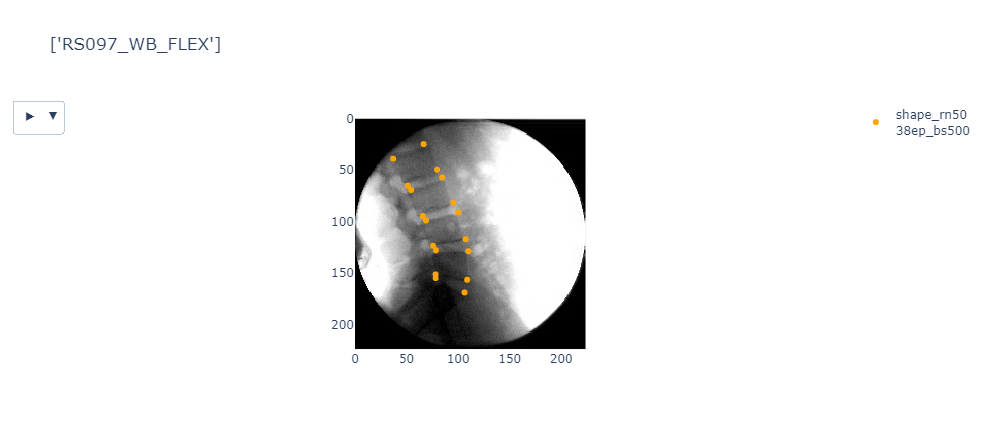

In [28]:
fig.show()
fig.write_html(pcode_to_plot +"_"+ exp +"_PREDS.html", auto_play = False)